In [123]:
!pip install squarify

Defaulting to user installation because normal site-packages is not writeable


In [124]:
!pip install stemgraphic

Defaulting to user installation because normal site-packages is not writeable


In [125]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import math
import random
import statistics
import openpyxl
from openpyxl.styles import PatternFill
import squarify
import stemgraphic
import plotly.graph_objects as go
import plotly.express as px
import scipy.stats as stats
import mlxtend
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules
from mlxtend.frequent_patterns import fpgrowth
import warnings
warnings.filterwarnings('ignore')

In [226]:
df=pd.read_csv(r"C:\Users\himan\Downloads\drugs_side_effects_drugs_com.csv")

In [127]:
df.head()

,drug_name,medical_condition,side_effects,generic_name,drug_classes,brand_names,activity,rx_otc,pregnancy_category,csa,alcohol,related_drugs,medical_condition_description,rating,no_of_reviews,drug_link,medical_condition_url
0,doxycycline,Acne,"(hives, difficult breathing, swelling in your ...",doxycycline,"Miscellaneous antimalarials, Tetracyclines","Acticlate, Adoxa CK, Adoxa Pak, Adoxa TT, Alod...",87%,Rx,D,N,X,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,6.8,760.0,https://www.drugs.com/doxycycline.html,https://www.drugs.com/condition/acne.html
1,spironolactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...","Aldactone, CaroSpir",82%,Rx,C,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.2,449.0,https://www.drugs.com/spironolactone.html,https://www.drugs.com/condition/acne.html
2,minocycline,Acne,"skin rash, fever, swollen glands, flu-like sym...",minocycline,Tetracyclines,"Dynacin, Minocin, Minolira, Solodyn, Ximino, V...",48%,Rx,D,N,NaN,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,5.7,482.0,https://www.drugs.com/minocycline.html,https://www.drugs.com/condition/acne.html
3,Accutane,Acne,problems with your vision or hearing; muscle o...,isotretinoin (oral),"Miscellaneous antineoplastics, Miscellaneous u...",NaN,41%,Rx,X,N,X,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.9,623.0,https://www.drugs.com/accutane.html,https://www.drugs.com/condition/acne.html
4,clindamycin,Acne,hives ; difficult breathing; swelling of your ...,clindamycin topical,"Topical acne agents, Vaginal anti-infectives","Cleocin T, Clindacin ETZ, Clindacin P, Clindag...",39%,Rx,B,N,NaN,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.4,146.0,https://www.drugs.com/mtm/clindamycin-topical....,https://www.drugs.com/condition/acne.html


In [128]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2931 entries, 0 to 2930
Data columns (total 17 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   drug_name                      2931 non-null   object 
 1   medical_condition              2931 non-null   object 
 2   side_effects                   2807 non-null   object 
 3   generic_name                   2888 non-null   object 
 4   drug_classes                   2849 non-null   object 
 5   brand_names                    1718 non-null   object 
 6   activity                       2931 non-null   object 
 7   rx_otc                         2930 non-null   object 
 8   pregnancy_category             2702 non-null   object 
 9   csa                            2931 non-null   object 
 10  alcohol                        1377 non-null   object 
 11  related_drugs                  1462 non-null   object 
 12  medical_condition_description  2931 non-null   o

In [129]:
df.describe

<bound method NDFrame.describe of            drug_name medical_condition  \
0        doxycycline              Acne   
1     spironolactone              Acne   
2        minocycline              Acne   
3           Accutane              Acne   
4        clindamycin              Acne   
...              ...               ...   
2926   benzphetamine       Weight Loss   
2927    fenfluramine       Weight Loss   
2928     Fendique ER       Weight Loss   
2929        Imcivree       Weight Loss   
2930   setmelanotide       Weight Loss   

                                           side_effects  \
0     (hives, difficult breathing, swelling in your ...   
1     hives ; difficulty breathing; swelling of your...   
2     skin rash, fever, swollen glands, flu-like sym...   
3     problems with your vision or hearing; muscle o...   
4     hives ; difficult breathing; swelling of your ...   
...                                                 ...   
2926  hives ; difficulty breathing; swelling of 

In [130]:
print(f"row= {df.shape[0]}\ncolumns= {df.shape[1]}")

row= 2931
columns= 17


In [131]:
df.isna().sum()

drug_name                           0
medical_condition                   0
side_effects                      124
generic_name                       43
drug_classes                       82
brand_names                      1213
activity                            0
rx_otc                              1
pregnancy_category                229
csa                                 0
alcohol                          1554
related_drugs                    1469
medical_condition_description       0
rating                           1345
no_of_reviews                    1345
drug_link                           0
medical_condition_url               0
dtype: int64

In [228]:
df=df.drop(['drug_link','medical_condition_url'],axis=1)

In [230]:
df[['pregnancy_category','alcohol']]=df[['pregnancy_category','alcohol']].fillna(0)

In [134]:
df.head()

,drug_name,medical_condition,side_effects,generic_name,drug_classes,brand_names,activity,rx_otc,pregnancy_category,csa,alcohol,related_drugs,medical_condition_description,rating,no_of_reviews
0,doxycycline,Acne,"(hives, difficult breathing, swelling in your ...",doxycycline,"Miscellaneous antimalarials, Tetracyclines","Acticlate, Adoxa CK, Adoxa Pak, Adoxa TT, Alod...",87%,Rx,D,N,X,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,6.8,760.0
1,spironolactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...","Aldactone, CaroSpir",82%,Rx,C,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.2,449.0
2,minocycline,Acne,"skin rash, fever, swollen glands, flu-like sym...",minocycline,Tetracyclines,"Dynacin, Minocin, Minolira, Solodyn, Ximino, V...",48%,Rx,D,N,0,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,5.7,482.0
3,Accutane,Acne,problems with your vision or hearing; muscle o...,isotretinoin (oral),"Miscellaneous antineoplastics, Miscellaneous u...",NaN,41%,Rx,X,N,X,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.9,623.0
4,clindamycin,Acne,hives ; difficult breathing; swelling of your ...,clindamycin topical,"Topical acne agents, Vaginal anti-infectives","Cleocin T, Clindacin ETZ, Clindacin P, Clindag...",39%,Rx,B,N,0,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.4,146.0


In [135]:
df['pregnancy_category'].unique()

array(['D', 'C', 'X', 'B', 'N', 0, 'A'], dtype=object)

In [136]:
med_con=df['medical_condition'].unique()
med_con

array(['Acne', 'ADHD', 'AIDS/HIV', 'Allergies', "Alzheimer's", 'Angina',
       'Anxiety', 'Asthma', 'Bipolar Disorder', 'Bronchitis', 'Cancer',
       'Cholesterol', 'Colds & Flu', 'Constipation', 'COPD', 'Covid 19',
       'Depression', 'Diabetes (Type 1)', 'Diabetes (Type 2)', 'Diarrhea',
       'Eczema', 'Erectile Dysfunction', 'Gastrointestinal',
       'GERD (Heartburn)', 'Gout', 'Hair Loss', 'Hayfever', 'Herpes',
       'Hypertension', 'Hypothyroidism', 'IBD (Bowel)', 'Incontinence',
       'Insomnia', 'Menopause', 'Migraine', 'Osteoarthritis',
       'Osteoporosis', 'Pain', 'Pneumonia', 'Psoriasis',
       'Rheumatoid Arthritis', 'Schizophrenia', 'Seizures', 'Stroke',
       'Swine Flu', 'UTI', 'Weight Loss'], dtype=object)

In [137]:
drugs=df['drug_name'].unique()
drugs

array(['doxycycline', 'spironolactone', 'minocycline', ..., 'Fendique ER',
       'Imcivree', 'setmelanotide'], dtype=object)

In [138]:
import nltk
from nltk.tokenize import sent_tokenize
nltk.download('stopwords')
import string

def tokenize(document):
    words=[]
    document=str(document)
    lower_case=document.lower()
    tokenized=nlkt.tokenize.word_tokenize(document)

    for word in tokenize:
        if(word not in string.punctuation and word not in nlkt.corpus.stopwords.words("english")):
           words.append(word)
    return words

side_effects=[]
for i in side_effects:
    words=tokenize(data['side_effects'][i])
    words=list(set(words))
    side_effects.append(words)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\himan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [139]:
related_drugs = []
for i in df.index:
    strings = []
    string = ""
    for aa in range(len(str(df["related_drugs"][i]))):
        if str(df["related_drugs"][i])[aa] == ":":
            strings.append(string)
            string = ""
            break
        else:
            string += str(df["related_drugs"][i])[aa]
    string = ""
    for j in range(len(str(df["related_drugs"][i]))):
        if str(df["related_drugs"][i])[j] == "|":
            for k in range(j+2, len(str(df["related_drugs"][i]))):
                if str(df["related_drugs"][i][k]) == ":":
                    strings.append(string)
                    string = ""
                    break
                else:
                    string += str(df["related_drugs"][i][k])
            j = k
    related_drugs.append(strings)

In [140]:
df.columns

Index(['drug_name', 'medical_condition', 'side_effects', 'generic_name',
       'drug_classes', 'brand_names', 'activity', 'rx_otc',
       'pregnancy_category', 'csa', 'alcohol', 'related_drugs',
       'medical_condition_description', 'rating', 'no_of_reviews'],
      dtype='object')

In [142]:
import nltk
nltk.data.clear_cache()


In [143]:
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\himan\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [144]:
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\himan\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [232]:
import re
import string
from nltk.corpus import stopwords

# Load English stopwords
stop_words = set(stopwords.words("english"))

# Tokenization Function
def tokenize(document):
    document = str(document).lower()  # Convert to lowercase
    tokenized = re.findall(r'\b\w+\b', document)  # Tokenize without punkt
    # Remove stopwords and punctuation
    words = [
        word for word in tokenized
        if word not in stop_words and word not in string.punctuation
    ]
    return list(set(words))  # Return unique words

# Ensure unique medical conditions
med_con = df["medical_condition"].unique()

# Extract one description per condition
medical_condition_descriptions = []
for condition in med_con:
    match = df[df["medical_condition"] == condition]
    if not match.empty:
        medical_condition_descriptions.append(match["medical_condition_description"].values[0])

# Tokenize each description
tokenized_medical_condition_descriptions = [
    tokenize(desc) for desc in medical_condition_descriptions
]

# Optional: Display results
for i, tokens in enumerate(tokenized_medical_condition_descriptions):
    print(f"{med_con[i]}: {tokens}")


Acne: ['mild', 'seeing', 'surface', 'squeeze', 'permanent', 'close', 'soon', 'hormonal', 'pick', 'clears', 'oily', 'injections', 'ingredients', 'trapped', 'clogged', 'counter', 'father', 'applied', 'twice', 'lotions', 'uncle', 'environment', 'irritation', 'constantly', 'cleanser', 'resulting', 'therapy', '30s', 'appear', 'caused', 'standards', 'food', 'beds', 'oral', 'shy', 'greasy', 'lumps', 'headbands', 'hormones', 'palmitate', 'back', 'proactive', 'gels', 'contain', 'onset', 'hair', 'avoid', 'filled', 'care', 'small', 'eg', 'lot', 'become', 'peroxide', 'sodium', 'resorcinol', 'condition', 'dark', 'dapsone', 'break', 'antibiotics', 'detergents', 'makes', 'flake', 'zits', 'clog', 'course', 'lauryl', 'usually', 'papules', 'naturally', 'beneath', 'mother', 'helps', 'play', '30', 'oleth', '40', 'topical', 'chances', 'irritate', 'gently', 'doctor', 'vary', 'redness', 'prescription', 'clogging', 'stearate', 'tends', 'feel', 'develop', 'suffer', 'girls', 'photodynamic', 'uncommon', '7', 'wo

In [169]:
import pandas as pd
import re
# Tokenization function
def process(text_series):
    text = " ".join(text_series.dropna().astype(str)).lower()
    tokens = re.findall(r'\b\w+\b', text)
    return tokens

# Group the DataFrame by medical_condition
grouped = df.groupby("medical_condition")

# Process side_effects for each group
side_effects = [process(group) for _, group in grouped["side_effects"]]

# Create a list of medical conditions
medical_conditions_list = list(grouped.groups.keys())

# Create a dictionary mapping condition -> tokenized side effects
side_effects_dict = dict(zip(medical_conditions_list, side_effects))

# Sample data access
sample = 0
condition = df['medical_condition'][sample]

# Display results
print("SAMPLE TOKENIZED DATA\n")
print(f"Drug_name: {df['drug_name'][sample]}")
print(f"Medical Condition: {condition}")
print(f"Side Effects: {side_effects_dict.get(condition)}")


SAMPLE TOKENIZED DATA

Drug_name: doxycycline
Medical Condition: Acne
Side Effects: ['hives', 'difficult', 'breathing', 'swelling', 'in', 'your', 'face', 'or', 'throat', 'or', 'a', 'severe', 'skin', 'reaction', 'fever', 'sore', 'throat', 'burning', 'in', 'your', 'eyes', 'skin', 'pain', 'red', 'or', 'purple', 'skin', 'rash', 'that', 'spreads', 'and', 'causes', 'blistering', 'and', 'peeling', 'seek', 'medical', 'treatment', 'if', 'you', 'have', 'a', 'serious', 'drug', 'reaction', 'that', 'can', 'affect', 'many', 'parts', 'of', 'your', 'body', 'symptoms', 'may', 'include', 'skin', 'rash', 'fever', 'swollen', 'glands', 'flu', 'like', 'symptoms', 'muscle', 'aches', 'severe', 'weakness', 'unusual', 'bruising', 'or', 'yellowing', 'of', 'your', 'skin', 'or', 'eyes', 'this', 'reaction', 'may', 'occur', 'several', 'weeks', 'after', 'you', 'began', 'using', 'doxycycline', 'doxycycline', 'may', 'cause', 'serious', 'side', 'effects', 'call', 'your', 'doctor', 'at', 'once', 'if', 'you', 'have', 'sev

In [234]:
print("After data preprocessing, data is as follows:")
df

After data preprocessing, data is as follows:


,drug_name,medical_condition,side_effects,generic_name,drug_classes,brand_names,activity,rx_otc,pregnancy_category,csa,alcohol,related_drugs,medical_condition_description,rating,no_of_reviews
0,doxycycline,Acne,"(hives, difficult breathing, swelling in your ...",doxycycline,"Miscellaneous antimalarials, Tetracyclines","Acticlate, Adoxa CK, Adoxa Pak, Adoxa TT, Alod...",87%,Rx,D,N,X,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,6.8,760.0
1,spironolactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...","Aldactone, CaroSpir",82%,Rx,C,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.2,449.0
2,minocycline,Acne,"skin rash, fever, swollen glands, flu-like sym...",minocycline,Tetracyclines,"Dynacin, Minocin, Minolira, Solodyn, Ximino, V...",48%,Rx,D,N,0,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,5.7,482.0
3,Accutane,Acne,problems with your vision or hearing; muscle o...,isotretinoin (oral),"Miscellaneous antineoplastics, Miscellaneous u...",NaN,41%,Rx,X,N,X,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.9,623.0
4,clindamycin,Acne,hives ; difficult breathing; swelling of your ...,clindamycin topical,"Topical acne agents, Vaginal anti-infectives","Cleocin T, Clindacin ETZ, Clindacin P, Clindag...",39%,Rx,B,N,0,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.4,146.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2926,benzphetamine,Weight Loss,hives ; difficulty breathing; swelling of your...,benzphetamine,"Anorexiants, CNS stimulants","Didrex, Regimex",2%,Rx,X,3,X,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,7.5,17.0
2927,fenfluramine,Weight Loss,hives ; difficult breathing; swelling of your ...,fenfluramine,"Anorexiants, CNS stimulants, Miscellaneous ant...",Fintepla,1%,Rx,C,4,X,NaN,Weight Loss (Obesity/Overweight) More than hal...,NaN,NaN
2928,Fendique ER,Weight Loss,NaN,phendimetrazine tartrate,"Anorexiants, CNS stimulants",NaN,0%,Rx,C,3,X,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,NaN,NaN
2929,Imcivree,Weight Loss,"Imcivree may cause serious side effects, inclu...",setmelanotide,Melanocortin receptor agonists,NaN,0%,Rx,0,N,0,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,NaN,NaN


In [171]:
print(f"Dimension of the dataset: {df.shape}\n")
cnt = 0
for i in df.columns:
    print(f"Mode in column {df.columns[cnt]}: {statistics.mode(df[df.columns[cnt]])}")
    cnt += 1
print("\n")

print(f"Data types of each column:\n{df.dtypes}\n")

Dimension of the dataset: (2931, 15)

Mode in column drug_name: triamcinolone
Mode in column medical_condition: Pain
Mode in column side_effects: nan
Mode in column generic_name: nan
Mode in column drug_classes: Upper respiratory combinations
Mode in column brand_names: nan
Mode in column activity: 0%
Mode in column rx_otc: Rx
Mode in column pregnancy_category: C
Mode in column csa: N
Mode in column alcohol: 0
Mode in column related_drugs: nan
Mode in column medical_condition_description: Pain An unpleasant sensory and emotional experience associated with actual or potential tissue damage or described in terms of such damage.
Mode in column rating: 10.0
Mode in column no_of_reviews: 1.0


Data types of each column:
drug_name                         object
medical_condition                 object
side_effects                      object
generic_name                      object
drug_classes                      object
brand_names                       object
activity                     

drug_name                           0
medical_condition                   0
side_effects                      124
generic_name                       43
drug_classes                       82
brand_names                      1213
activity                            0
rx_otc                              1
pregnancy_category                  0
csa                                 0
alcohol                             0
related_drugs                    1469
medical_condition_description       0
rating                           1345
no_of_reviews                    1345
dtype: int64

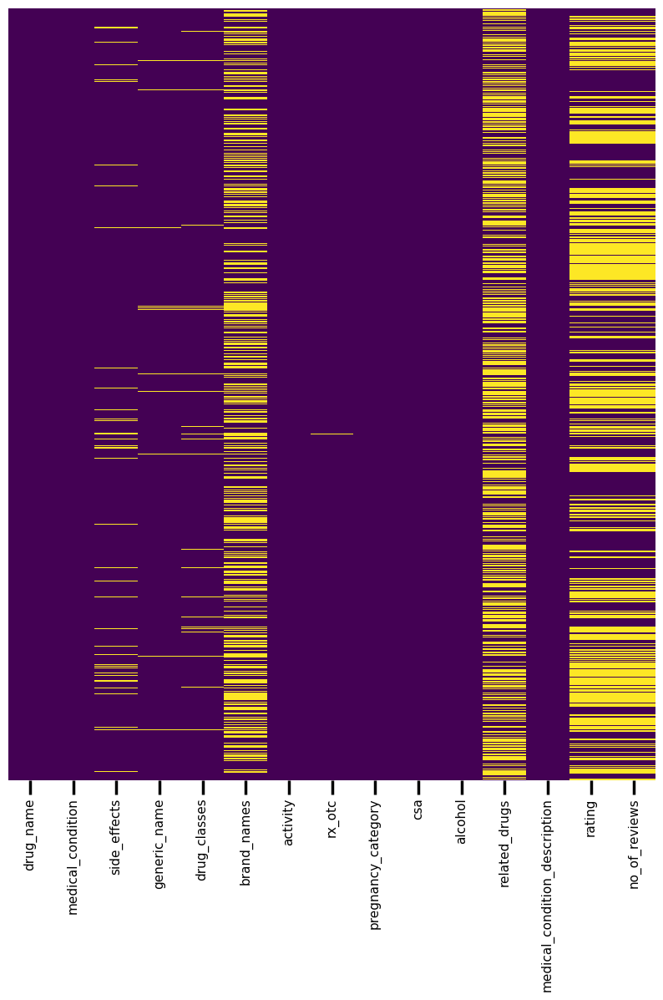

In [172]:
import seaborn as sns
plt.figure(figsize=(10,12))
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')
df.isnull().sum()

In [173]:
unique_medical_conditions = list(df.medical_condition.unique())
unique_drugs = list(df.drug_name.unique())

print(f"List of unique Medical Conditions being discussed are:\n{unique_medical_conditions}\n\n")
print(f"List of unique drugs being discussed are:\n{unique_drugs}\n\n")

print(f"Number of unique drugs: {len(unique_drugs)}")
print(f"Total data rows: {df.shape[0]}")

List of unique Medical Conditions being discussed are:
['Acne', 'ADHD', 'AIDS/HIV', 'Allergies', "Alzheimer's", 'Angina', 'Anxiety', 'Asthma', 'Bipolar Disorder', 'Bronchitis', 'Cancer', 'Cholesterol', 'Colds & Flu', 'Constipation', 'COPD', 'Covid 19', 'Depression', 'Diabetes (Type 1)', 'Diabetes (Type 2)', 'Diarrhea', 'Eczema', 'Erectile Dysfunction', 'Gastrointestinal', 'GERD (Heartburn)', 'Gout', 'Hair Loss', 'Hayfever', 'Herpes', 'Hypertension', 'Hypothyroidism', 'IBD (Bowel)', 'Incontinence', 'Insomnia', 'Menopause', 'Migraine', 'Osteoarthritis', 'Osteoporosis', 'Pain', 'Pneumonia', 'Psoriasis', 'Rheumatoid Arthritis', 'Schizophrenia', 'Seizures', 'Stroke', 'Swine Flu', 'UTI', 'Weight Loss']


List of unique drugs being discussed are:
['doxycycline', 'spironolactone', 'minocycline', 'Accutane', 'clindamycin', 'Aldactone', 'tretinoin', 'isotretinoin', 'Bactrim', 'Retin-A', 'Aczone', 'benzoyl peroxide', 'Differin', 'Epiduo', 'adapalene', 'cephalexin', 'Doryx', 'tetracycline', 'Septr

In [176]:
drugs_multiple_condns = []
drugs_so_far = []

for i in df.index:
    if df["drug_name"][i] in drugs_so_far and df["drug_name"][i] not in drugs_multiple_condns:
        drugs_multiple_condns.append(df["drug_name"][i])
    if df["drug_name"][i] not in drugs_so_far:
        drugs_so_far.append(df["drug_name"][i])

print("The below is the list of only drugs that have multi-purpose:")
for i in drugs_multiple_condns:
    print(i)

The below is the list of only drugs that have multi-purpose:
minocycline
erythromycin
triamcinolone
fluocinolone
doxepin
fluticasone
mometasone
beclomethasone
ciclesonide
acyclovir
minoxidil
budesonide
hydrocortisone
cromolyn
diclofenac
diphenhydramine
clindamycin
betamethasone


In [178]:
df.columns

Index(['drug_name', 'medical_condition', 'side_effects', 'generic_name',
       'drug_classes', 'brand_names', 'activity', 'rx_otc',
       'pregnancy_category', 'csa', 'alcohol', 'related_drugs',
       'medical_condition_description', 'rating', 'no_of_reviews'],
      dtype='object')

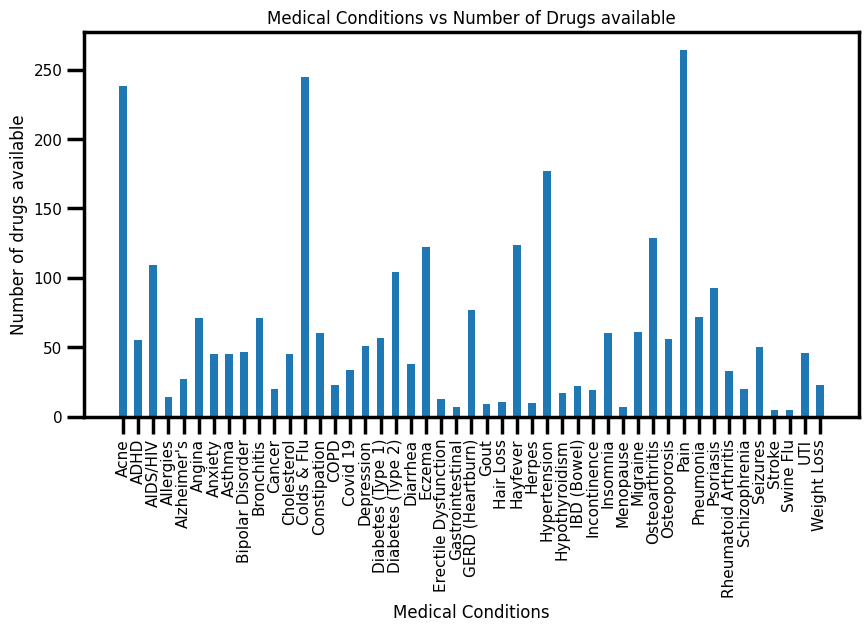

In [179]:
available_drugs_for_condns = [0]*len(med_con)

for i in df.index:
    medical_condition = str(df['medical_condition'][i])
    indexx = unique_medical_conditions.index(medical_condition)
    available_drugs_for_condns[indexx] += 1

#Bar Graph
fig = plt.figure(figsize = (10, 5))
# creating the bar plot
plt.bar(unique_medical_conditions, available_drugs_for_condns, width = 0.5)
plt.xlabel("Medical Conditions")
plt.ylabel(f"Number of drugs available")
plt.title(f"Medical Conditions vs Number of Drugs available")
plt.xticks(rotation=90)
plt.show()

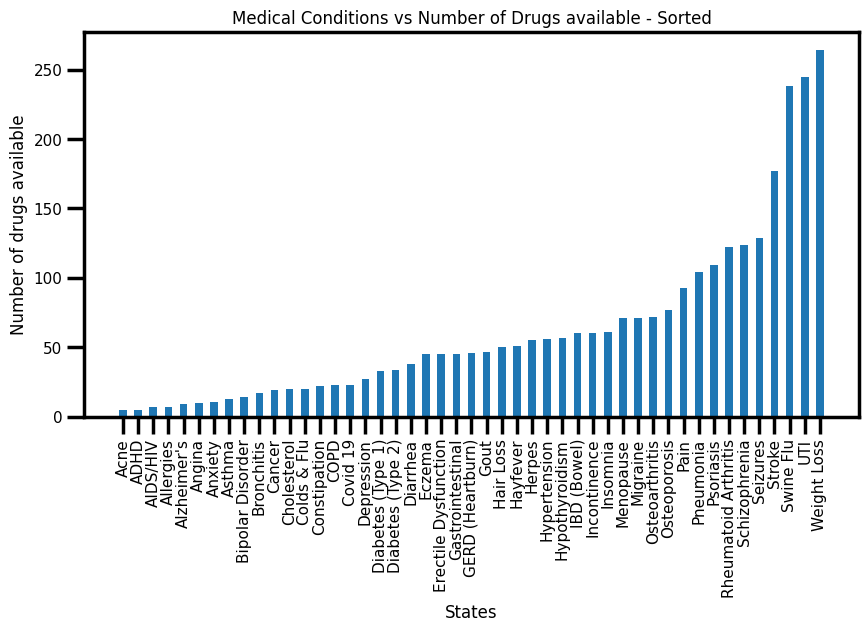

In [180]:
# Pareto Chart
available_drugs_for_condns, unique_med_con = zip(*sorted(zip(available_drugs_for_condns, unique_medical_conditions)))

#Bar Graph
fig = plt.figure(figsize = (10, 5))
# creating the bar plot
plt.bar(unique_medical_conditions, available_drugs_for_condns, width = 0.5)
plt.xlabel("States")
plt.ylabel(f"Number of drugs available")
plt.title(f"Medical Conditions vs Number of Drugs available - Sorted")
plt.xticks(rotation=90)
plt.show()

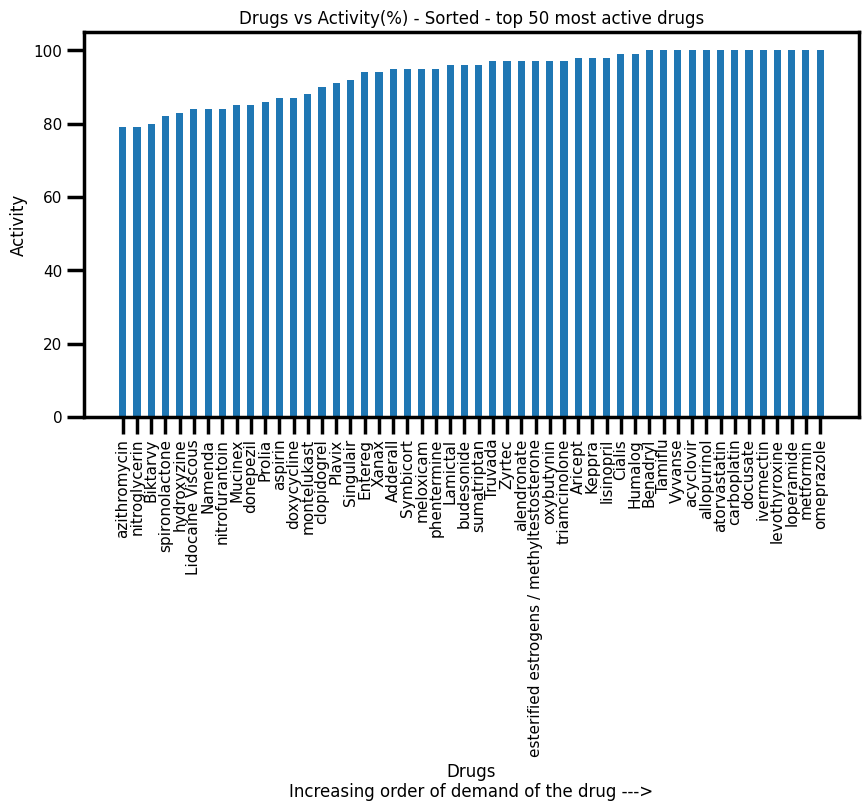

In [181]:
activities = []
drugs = []
for i in df.index:
    activities.append(int(df["activity"][i][:-1]))
    drugs.append(str(df["drug_name"][i]))


# Pareto Chart
activities, drugs = zip(*sorted(zip(activities, drugs)))

#Bar Graph
fig = plt.figure(figsize = (10, 5))
# creating the bar plot
plt.bar(drugs[-50:], activities[-50:], width = 0.5)
plt.xlabel("Drugs\nIncreasing order of demand of the drug --->")
plt.ylabel(f"Activity")
plt.title(f"Drugs vs Activity(%) - Sorted - top 50 most active drugs")
plt.xticks(rotation=90)
plt.show()

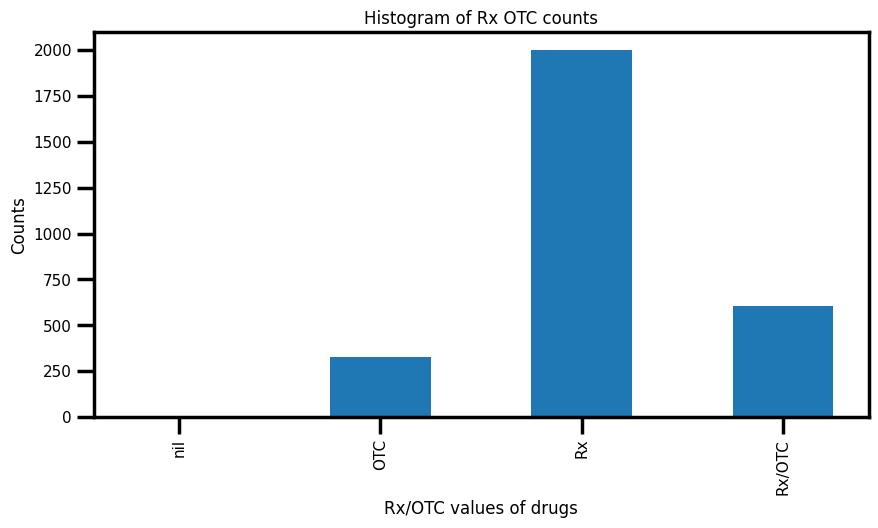

In [182]:
unique_rx_otc = ['nil', 'OTC', 'Rx', 'Rx/OTC']

cnts_rtx_otc = [0]*len(unique_rx_otc)
for i in df.index:
    if df["rx_otc"][i] == None:
        cnts_rtx_otc[0] += 1
    elif df["rx_otc"][i] == 'OTC':
        cnts_rtx_otc[1] += 1
    elif df["rx_otc"][i] == 'Rx':
        cnts_rtx_otc[2] += 1
    elif df["rx_otc"][i] == 'Rx/OTC':
        cnts_rtx_otc[3] += 1
        
# Pareto Chart
# cnts, unique_rx_otc = zip(*sorted(zip(cnts, unique_rx_otc)))

#Bar Graph
fig = plt.figure(figsize = (10, 5))
# creating the bar plot
plt.bar(unique_rx_otc, cnts_rtx_otc, width = 0.5)
plt.xlabel("Rx/OTC values of drugs")
plt.ylabel(f"Counts")
plt.title(f"Histogram of Rx OTC counts")
plt.xticks(rotation=90)
plt.show()

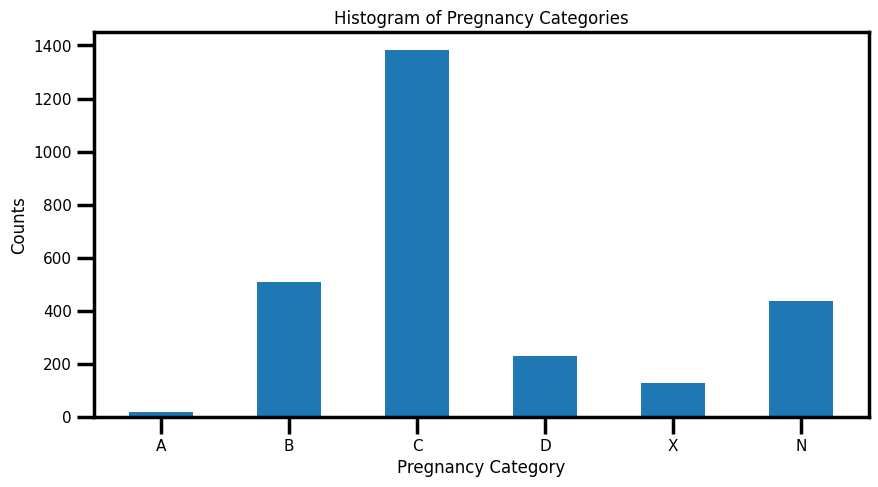

In [184]:
pregnancy_categories = ['A', 'B', 'C', 'D', 'X', 'N']

cnts_preg_cat = [0]*len(pregnancy_categories)
for i in df.index:
    if df["pregnancy_category"][i] == 'A':
        cnts_preg_cat[0] += 1
    elif df["pregnancy_category"][i] == 'B':
        cnts_preg_cat[1] += 1
    elif df["pregnancy_category"][i] == 'C':
        cnts_preg_cat[2] += 1
    elif df["pregnancy_category"][i] == 'D':
        cnts_preg_cat[3] += 1
    elif df["pregnancy_category"][i] == 'X':
        cnts_preg_cat[4] += 1
    elif df["pregnancy_category"][i] == 'N':
        cnts_preg_cat[5] += 1
    
        
# Pareto Chart
#Bar Graph
fig = plt.figure(figsize = (10, 5))
# creating the bar plot
plt.bar(pregnancy_categories, cnts_preg_cat, width = 0.5)
plt.xlabel("Pregnancy Category")
plt.ylabel(f"Counts")
plt.title(f"Histogram of Pregnancy Categories")
plt.xticks(rotation=0)
plt.show()

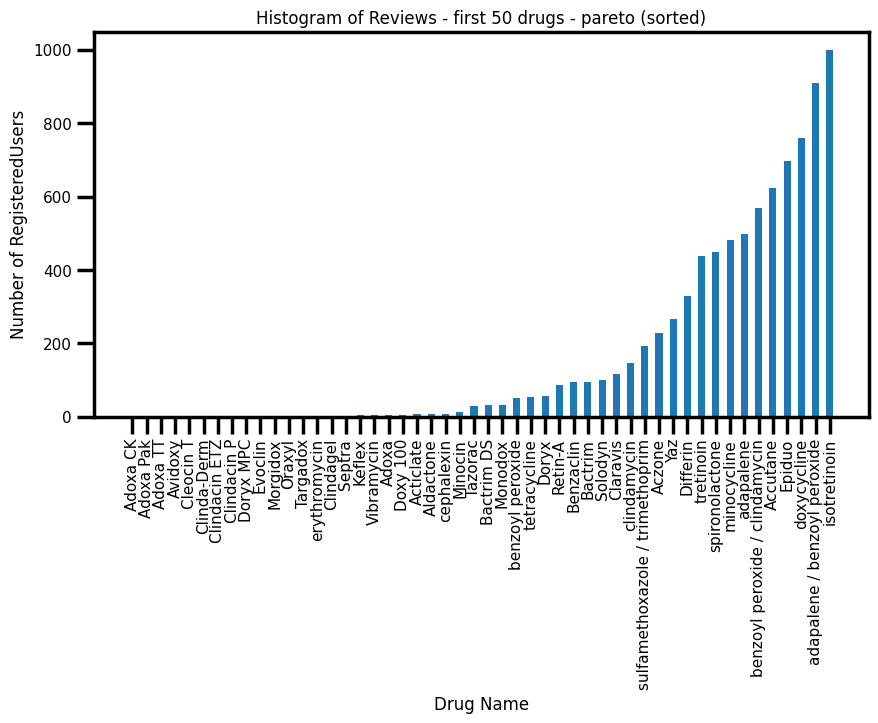

In [186]:
drug_names = []
no_of_ratings = []

num = 50

cnt = 0
for i in df.index:
    if cnt != num:
        drug_names.append(df["drug_name"][i])
        if not np.isnan(df["no_of_reviews"][i]):
            no_of_ratings.append(int(df["no_of_reviews"][i]))
        else:
            no_of_ratings.append(0)
    else:
        break
    cnt += 1

#Bar Graph
fig = plt.figure(figsize = (10, 5))
no_of_ratings, drug_names = zip(*sorted(zip(no_of_ratings, drug_names)))
# creating the bar plot
# num = 10
plt.bar(drug_names, no_of_ratings, width = 0.5)
plt.xlabel("Drug Name")
plt.ylabel(f"Number of RegisteredUsers")
plt.title(f"Histogram of Reviews - first {num} drugs - pareto (sorted)")
plt.xticks(rotation=90)
plt.show()

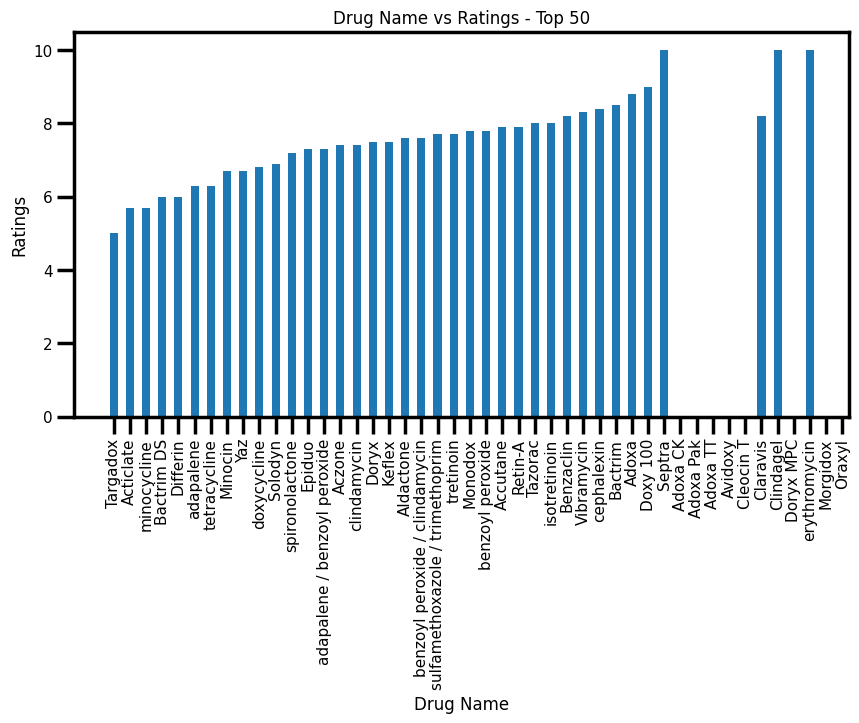

In [187]:
num = 50
drug_names = df["drug_name"][:num]
ratings = df["rating"][:num]
ratings, drug_names = zip(*sorted(zip(ratings, drug_names)))        
# Pareto Chart
#Bar Graph
fig = plt.figure(figsize = (10, 5))
# creating the bar plot
plt.bar(drug_names, ratings, width = 0.5)
plt.xlabel("Drug Name")
plt.ylabel(f"Ratings")
plt.title(f"Drug Name vs Ratings - Top {num}")
plt.xticks(rotation=90)
plt.show()

<Axes: xlabel='rating', ylabel='count'>

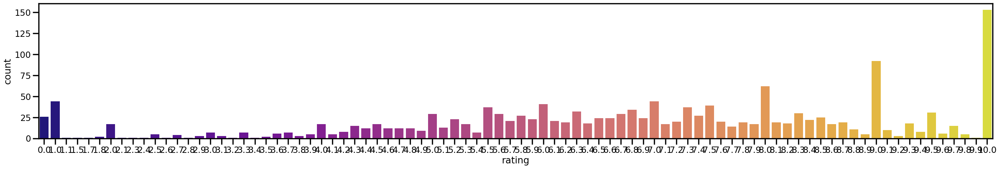

In [188]:
sns.set_context('poster', font_scale=0.8)
plt.figure(figsize=(35,5))
sns.countplot(data=df,x = 'rating',palette='plasma')

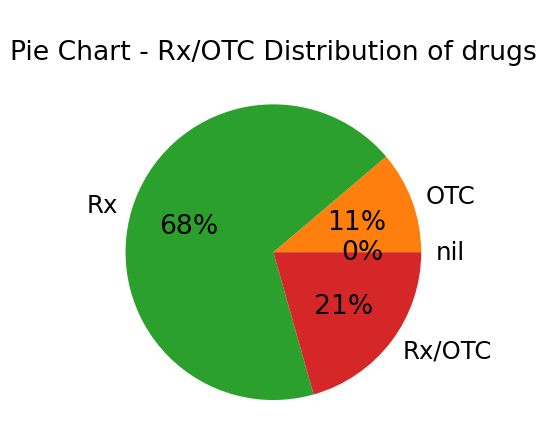

In [191]:
y = np.array(cnts_rtx_otc)
mylabels = unique_rx_otc
plt.title("\nPie Chart - Rx/OTC Distribution of drugs")
plt.pie(y, labels = mylabels, autopct='%.0f%%')
plt.show() 

pregnancy_category
C    1382
B     509
N     436
0     229
D     228
X     129
A      18
Name: count, dtype: int64

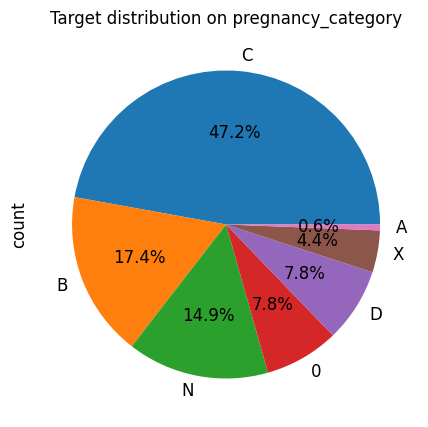

In [40]:
sns.set_context('poster', font_scale=0.5)
plt.figure(figsize=(5,5))
# Pie plot
df['pregnancy_category'].value_counts().plot.pie(autopct='%1.1f%%', textprops={'fontsize':12}).set_title("Target distribution on pregnancy_category")
df['pregnancy_category'].value_counts()

Text(0.5, 1.0, 'Target distribution on medical_condition ')

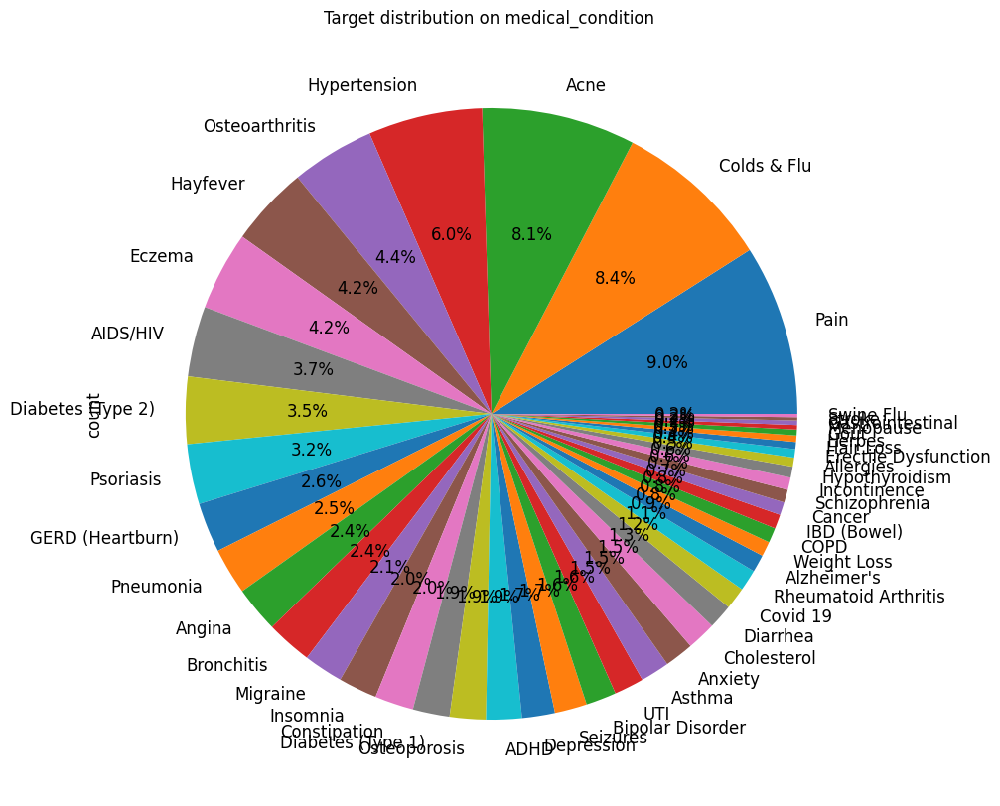

In [41]:
sns.set_context('poster', font_scale=0.5)
plt.figure(figsize=(10,10))
# Pie plot
df['medical_condition'].value_counts().plot.pie(autopct='%1.1f%%', textprops={'fontsize':12}).set_title("Target distribution on medical_condition ")



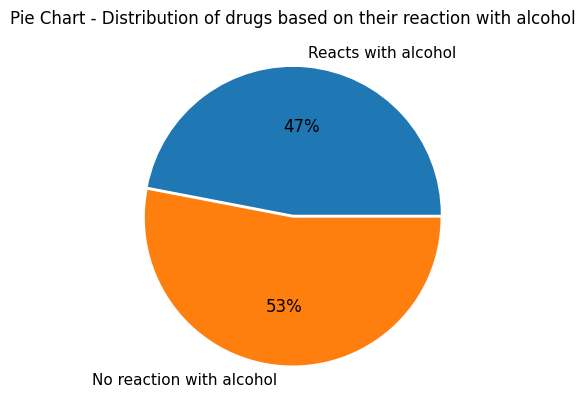

In [42]:
cnts = 0

for i in df.index:
    if df["alcohol"][i] == 'X':
        cnts += 1
cnts_alcohol = [cnts, df.shape[0] - cnts]
mylabels = ["Reacts with alcohol", "No reaction with alcohol"]

# Alcohol
y = np.array(cnts_alcohol)
# mylabels = unique_rx_otc
myexplode = [0.01]*2
plt.title("Pie Chart - Distribution of drugs based on their reaction with alcohol")
plt.pie(y, labels = mylabels, explode = myexplode, autopct='%.0f%%')
plt.show()

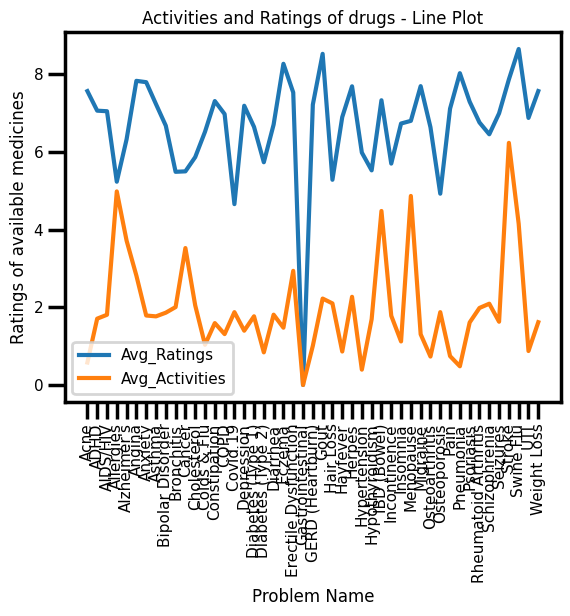

In [43]:

avg_ratings = [0]*len(unique_medical_conditions)
avg_denominator = [0]*len(unique_medical_conditions)
avg_activities = [0]*len(unique_medical_conditions)
for i in range(len(unique_medical_conditions)):
    for j in df.index:
        if str(df["medical_condition"][j]) == unique_medical_conditions[i] and not np.isnan(df["rating"][j]):
            avg_ratings[i] += float(df["rating"][j])
            avg_denominator[i] += 1
            avg_activities[i] += float(df["activity"][j][:-1])

for i in range(len(unique_medical_conditions)):
    if avg_denominator[i] != 0:
        avg_ratings[i] = avg_ratings[i]/avg_denominator[i]
        avg_activities[i] = (avg_activities[i]/avg_denominator[i])/10

    
plt.plot(unique_medical_conditions, np.array(avg_ratings))
plt.plot(unique_medical_conditions, np.array(avg_activities))
plt.xlabel(f"Problem Name")
plt.ylabel(f"Ratings of available medicines")
plt.title(f"Activities and Ratings of drugs - Line Plot")
plt.legend(["Avg_Ratings", "Avg_Activities"])
plt.xticks(rotation=90)
plt.show()

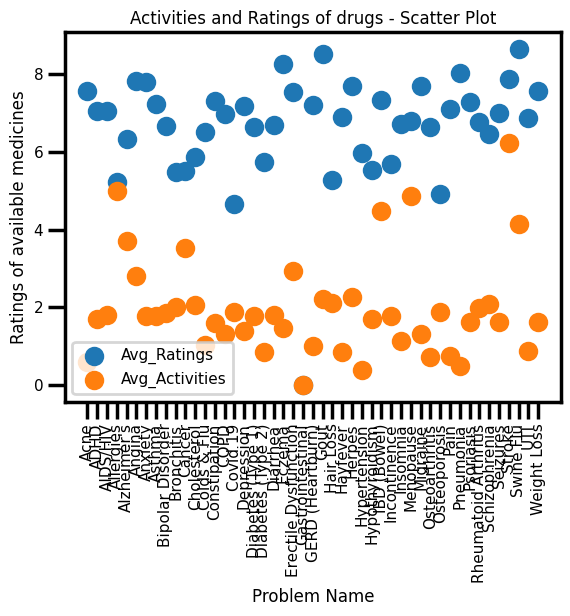

In [44]:
plt.scatter(unique_medical_conditions, np.array(avg_ratings))
plt.scatter(unique_medical_conditions, np.array(avg_activities))
plt.xlabel(f"Problem Name")
plt.ylabel(f"Ratings of available medicines")
plt.title(f"Activities and Ratings of drugs - Scatter Plot")
plt.legend(["Avg_Ratings", "Avg_Activities"])
plt.xticks(rotation=90)
plt.show()

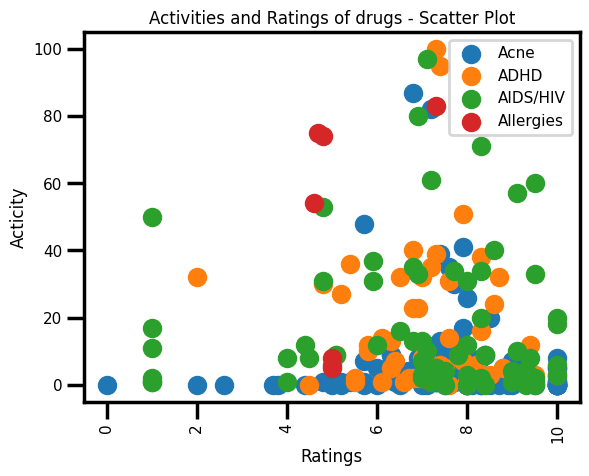

In [45]:
num = 4
diseases = unique_medical_conditions[:num]
property_chosen = [df["rating"], df["activity"]]

properties = []

for i in diseases:
    dataa = df.loc[df['medical_condition'] == i]
    rating = list(dataa["rating"])
    activity = []
    for j in dataa.index:
        activity.append(int(dataa["activity"][j][:-1]))
    plt.scatter(rating, activity)
    plt.xlabel(f"Ratings")
    plt.ylabel(f"Acticity")
    plt.title(f"Activities and Ratings of drugs - Scatter Plot")
    plt.legend(diseases)
    plt.xticks(rotation=90)

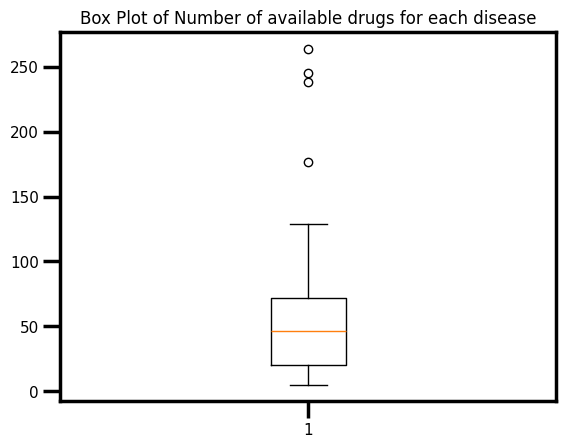

In [46]:
plt.boxplot(available_drugs_for_condns)
plt.title(f"Box Plot of Number of available drugs for each disease")
plt.show()

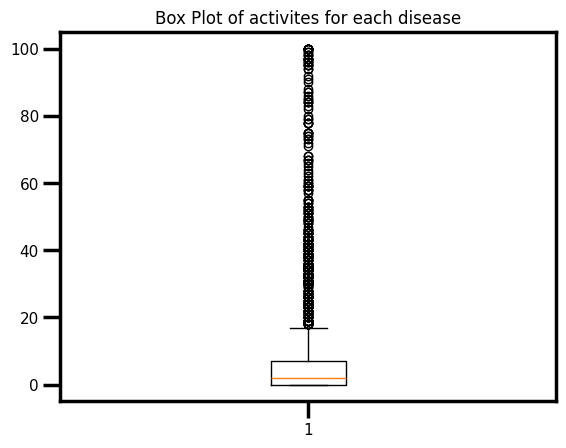

In [47]:

plt.boxplot(activities)
plt.title(f"Box Plot of activites for each disease")
plt.show()

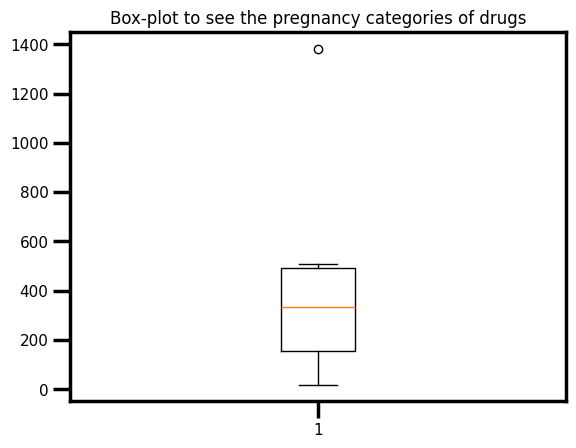

In [48]:
plt.boxplot(cnts_preg_cat)
plt.title(f"Box-plot to see the pregnancy categories of drugs")
plt.show()

In [49]:
import plotly.express as ex
ex.box(x = 'rx_otc', y = 'medical_condition',data_frame = df, template='seaborn', notched=True, width=800, height=500)

In [50]:
ex.box(x = 'medical_condition', y = 'drug_classes',data_frame = df, template='seaborn', notched=True, width=1200, height=600)


In [51]:
ex.box(x = 'medical_condition', y = 'pregnancy_category',data_frame = df, template='seaborn', notched=True, width=1200, height=600)


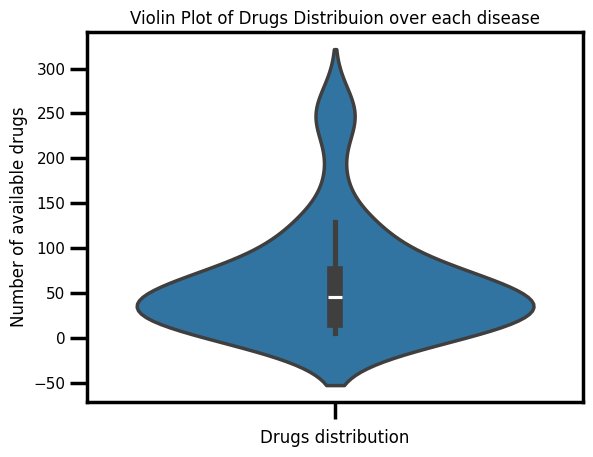

In [52]:
sns.violinplot(available_drugs_for_condns)
plt.xlabel(f"Drugs distribution")
plt.ylabel(f"Number of available drugs")
plt.title(f"Violin Plot of Drugs Distribuion over each disease")
plt.xticks(rotation=90)
plt.show()

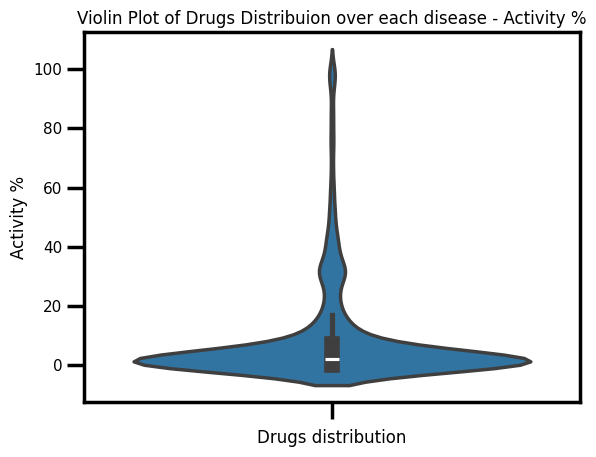

In [53]:
sns.violinplot(activities)
plt.xlabel(f"Drugs distribution")
plt.ylabel(f"Activity %")
plt.title(f"Violin Plot of Drugs Distribuion over each disease - Activity %")
plt.xticks(rotation=90)
plt.show()

(<Figure size 750x300 with 1 Axes>, <Axes: >)

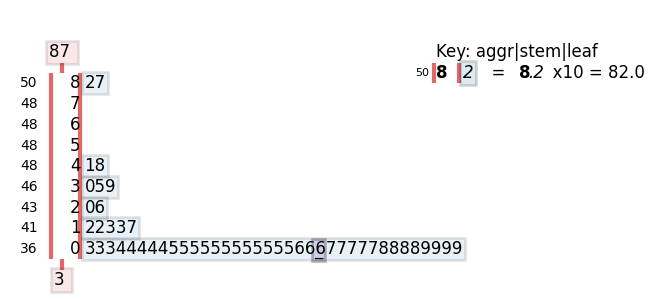

In [54]:
num = 50
activity = []
for i in df.index:
    activity.append(int(df["activity"][i][:-1]))
# print(f"Number of Reviews of the first {num} drugs")
stemgraphic.stem_graphic(activity[:num] , scale = 10)

In [55]:
categories = ["activity", "rating", "no_of_reviews"]

print("Radar Chart")
fig = go.Figure()
plt.Figure(figsize =(5, 3))

fig.add_trace(go.Scatterpolar(r=df.loc[df["medical_condition"] == 'Acne'], theta=categories, fill='toself', name='acne'))
fig.add_trace(go.Scatterpolar(r=df.loc[df["medical_condition"] == 'Anxiety'], theta=categories, fill='toself', name='anxiety'))
fig.add_trace(go.Scatterpolar(r=df.loc[df["medical_condition"] == 'Asthma'], theta=categories, fill='toself', name='asthma'))
fig.add_trace(go.Scatterpolar(r=df.loc[df["medical_condition"] == 'Weight Loss'], theta=categories, fill='toself', name='weight loss'))
fig.update_layout(autosize=False, width=400, height=400)

fig.show()

Radar Chart


In [56]:

arr = []
data = dict(time=available_drugs_for_condns,
            steps=unique_medical_conditions)

fig = px.funnel(data, x='time', y='steps')
print("Funnel Chart for Diseases and Available drugs")
fig.show()

Funnel Chart for Diseases and Available drugs


In [57]:
cnt = 0
for i in df.index:
    related_drugs[cnt].append(df["drug_name"][i])
    cnt += 1
    
print(related_drugs)

[['amoxicillin', 'prednisone', 'albuterol', 'ciprofloxacin', 'azithromycin', 'cephalexin', 'metronidazole', 'metronidazole topical', 'clindamycin topical', 'clindamycin', 'doxycycline'], ['amlodipine', 'lisinopril', 'losartan', 'metoprolol', 'furosemide', 'hydrochlorothiazide', 'carvedilol', 'warfarin', 'Lasix', 'bumetanide', 'spironolactone'], ['amoxicillin', 'prednisone', 'doxycycline', 'ciprofloxacin', 'azithromycin', 'cephalexin', 'metronidazole', 'clindamycin topical', 'Augmentin', 'dexamethasone', 'minocycline'], ['doxycycline', 'clindamycin topical', 'erythromycin topical', 'tetracycline', 'Tazorac', 'Accutane'], ['doxycycline', 'metronidazole', 'metronidazole topical', 'clindamycin', 'erythromycin topical', 'tetracycline', 'isotretinoin', 'tinidazole', 'Cleocin', 'MetroGel', 'clindamycin'], ['amlodipine', 'lisinopril', 'losartan', 'metoprolol', 'furosemide', 'hydrochlorothiazide', 'carvedilol', 'spironolactone', 'Lasix', 'bumetanide', 'Aldactone'], ['tretinoin'], ['doxycycline'

In [58]:
te = TransactionEncoder()
te_ary = te.fit_transform(related_drugs)

# Print the one-hot encoded Boolean array
print(te_ary)

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]


In [59]:
df1 = pd.DataFrame(te_ary, columns=te.columns_)
print(df)

           drug_name medical_condition  \
0        doxycycline              Acne   
1     spironolactone              Acne   
2        minocycline              Acne   
3           Accutane              Acne   
4        clindamycin              Acne   
...              ...               ...   
2926   benzphetamine       Weight Loss   
2927    fenfluramine       Weight Loss   
2928     Fendique ER       Weight Loss   
2929        Imcivree       Weight Loss   
2930   setmelanotide       Weight Loss   

                                           side_effects  \
0     (hives, difficult breathing, swelling in your ...   
1     hives ; difficulty breathing; swelling of your...   
2     skin rash, fever, swollen glands, flu-like sym...   
3     problems with your vision or hearing; muscle o...   
4     hives ; difficult breathing; swelling of your ...   
...                                                 ...   
2926  hives ; difficulty breathing; swelling of your...   
2927  hives ; difficult

In [60]:
frequent_itemsets = apriori(df1, min_support=0.01, use_colnames=True)

# Use the Association Rules algorithm to generate rules with a minimum confidence
rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.7)

# Print the frequent itemsets and association rules
print("Frequent Itemsets:")
print(frequent_itemsets)

print("\nAssociation Rules:")
print(rules)

Frequent Itemsets:
       support                                           itemsets
0     0.010235                                          (Abilify)
1     0.017741                                          (Atripla)
2     0.034459                                        (Augmentin)
3     0.012624                                         (Basaglar)
4     0.011941                                         (Belsomra)
...        ...                                                ...
2844  0.012624  (furosemide, hydrochlorothiazide, losartan, ca...
2845  0.015353  (doxycycline, cephalexin, clindamycin, amoxici...
2846  0.012282  (doxycycline, cephalexin, clindamycin, prednis...
2847  0.015353  (doxycycline, cephalexin, clindamycin, amoxici...
2848  0.010235  (doxycycline, cephalexin, clindamycin, prednis...

[2849 rows x 2 columns]

Association Rules:
                                      antecedents  \
0                                      (Complera)   
1                                     

In [61]:
max_len = frequent_itemsets["itemsets"].apply(lambda x: len(x)).max()

# Print only the last level of frequent itemsets
print("Frequent Itemsets (Level {}):".format(max_len))
last_level_itemsets = frequent_itemsets[frequent_itemsets["itemsets"].apply(lambda x: len(x))==max_len]
print(last_level_itemsets)

# Use the Association Rules algorithm to generate rules with a minimum confidence
rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.7)

# Print the association rules for the last level frequent itemsets
print("\nAssociation Rules for Frequent Itemsets (Level {}):".format(max_len))
last_level_rules = rules[rules["antecedents"].apply(lambda x: len(x)==max_len)]
print(last_level_rules)

Frequent Itemsets (Level 9):
       support                                           itemsets
2847  0.015353  (doxycycline, cephalexin, clindamycin, amoxici...
2848  0.010235  (doxycycline, cephalexin, clindamycin, prednis...

Association Rules for Frequent Itemsets (Level 9):
Empty DataFrame
Columns: [antecedents, consequents, antecedent support, consequent support, support, confidence, lift, leverage, conviction, zhangs_metric]
Index: []


In [62]:
import numpy as np
# Gather All Items of Each Transactions into Numpy Array
from itertools import chain
transaction = list(chain.from_iterable(related_drugs))
# converting to numpy array
transaction = np.array(transaction)
print(transaction)

['amoxicillin' 'prednisone' 'albuterol' ... 'methamphetamine' 'Alli'
 'setmelanotide']


In [63]:
df2 = pd.DataFrame(transaction, columns=["items"]) 
# Put 1 to Each Item For Making Countable Table, to be able to perform Group By
df2["incident_count"] = 1 
#  Delete NaN Items from Dataset
indexNames = df2[df2['items'] == "nan" ].index
df2.drop(indexNames , inplace=True)
# Making a New Appropriate Pandas DataFrame for Visualizations  
df_table = df2.groupby("items").sum().sort_values("incident_count", ascending=False).reset_index()
#  Initial Visualizations
df_table.head(5).style.background_gradient(cmap='Blues')

,items,incident_count
0,prednisone,372
1,aspirin,287
2,acetaminophen,209
3,doxycycline,208
4,naproxen,193


In [64]:
df_table["all"] = "Top 50 items" 
# creating tree map using plotly
fig = px.treemap(df_table.head(50), path=['all', "items"], values='incident_count',
                  color=df_table["incident_count"].head(50), hover_data=['items'],
                  color_continuous_scale='Blues',
                )
# ploting the treemap
fig.show()

In [65]:
te = TransactionEncoder()
te_ary = te.fit_transform(related_drugs)

# Print the one-hot encoded Boolean array
print(te_ary)
dataset = pd.DataFrame(te_ary, columns=te.columns_)

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]


In [66]:
first30 = df_table["items"].head(30).values 
# Extract Top 30
dataset = dataset.loc[:,first30] 
# shape of the dataset
dataset.shape

(2931, 30)

In [67]:
from mlxtend.frequent_patterns.fpgrowth import fpgrowth
#running the fpgrowth algorithm
res=fpgrowth(dataset,min_support=0.05, use_colnames=True)
# printing top 10
res

,support,itemsets
0,0.126919,(prednisone)
1,0.070966,(doxycycline)
2,0.055954,(Humira)
3,0.053565,(diphenhydramine)
4,0.050836,(Benadryl)
...,...,...
63,0.050495,"(Tylenol, tramadol, oxycodone, aspirin, naproxen)"
64,0.050495,"(Tylenol, tramadol, oxycodone, aspirin, acetam..."
65,0.050495,"(Tylenol, oxycodone, aspirin, acetaminophen, n..."
66,0.050495,"(tramadol, oxycodone, aspirin, acetaminophen, ..."


In [68]:
transactions = related_drugs
print(transactions[:10])

[['amoxicillin', 'prednisone', 'albuterol', 'ciprofloxacin', 'azithromycin', 'cephalexin', 'metronidazole', 'metronidazole topical', 'clindamycin topical', 'clindamycin', 'doxycycline'], ['amlodipine', 'lisinopril', 'losartan', 'metoprolol', 'furosemide', 'hydrochlorothiazide', 'carvedilol', 'warfarin', 'Lasix', 'bumetanide', 'spironolactone'], ['amoxicillin', 'prednisone', 'doxycycline', 'ciprofloxacin', 'azithromycin', 'cephalexin', 'metronidazole', 'clindamycin topical', 'Augmentin', 'dexamethasone', 'minocycline'], ['doxycycline', 'clindamycin topical', 'erythromycin topical', 'tetracycline', 'Tazorac', 'Accutane'], ['doxycycline', 'metronidazole', 'metronidazole topical', 'clindamycin', 'erythromycin topical', 'tetracycline', 'isotretinoin', 'tinidazole', 'Cleocin', 'MetroGel', 'clindamycin'], ['amlodipine', 'lisinopril', 'losartan', 'metoprolol', 'furosemide', 'hydrochlorothiazide', 'carvedilol', 'spironolactone', 'Lasix', 'bumetanide', 'Aldactone'], ['tretinoin'], ['doxycycline'

In [69]:
candidate_1_itemsets = []
for transaction in transactions:
    for item in transaction:
        if [item] not in candidate_1_itemsets:
            candidate_1_itemsets.append([item])
print(len(candidate_1_itemsets))                        
print(candidate_1_itemsets) 

3177
[['amoxicillin'], ['prednisone'], ['albuterol'], ['ciprofloxacin'], ['azithromycin'], ['cephalexin'], ['metronidazole'], ['metronidazole topical'], ['clindamycin topical'], ['clindamycin'], ['doxycycline'], ['amlodipine'], ['lisinopril'], ['losartan'], ['metoprolol'], ['furosemide'], ['hydrochlorothiazide'], ['carvedilol'], ['warfarin'], ['Lasix'], ['bumetanide'], ['spironolactone'], ['Augmentin'], ['dexamethasone'], ['minocycline'], ['erythromycin topical'], ['tetracycline'], ['Tazorac'], ['Accutane'], ['isotretinoin'], ['tinidazole'], ['Cleocin'], ['MetroGel'], ['Aldactone'], ['tretinoin'], ['Bactrim'], ['Retin-A'], ['Aczone'], ['ivermectin topical'], ['minocycline topical'], ['brimonidine topical'], ['oxymetazoline topical'], ['benzoyl peroxide'], ['Differin'], ['Epiduo'], ['adapalene'], ['Doryx'], ['Septra'], ['Solodyn'], ['Cosentyx'], ['Enbrel'], ['Humira'], ['Otezla'], ['Stelara'], ['Taltz'], ['Duobrii'], ['methotrexate'], ['Vibramycin'], ['ceftriaxone'], ['levofloxacin'], [

In [203]:
def prune(itemsets, min_support, transactions):
    frequent_itemsets = []
    for itemset in itemsets:
        support_count = 0
        for transaction in transactions:
            if set(itemset).issubset(set(transaction)):
                support_count += 1
        if support_count >= min_support:
            frequent_itemsets.append(itemset)
    return frequent_itemsets
frequent_itemsets = prune(candidate_1_itemsets, 100 , transactions)
print(len(frequent_itemsets))
print(frequent_itemsets)

32
[['amoxicillin'], ['prednisone'], ['ciprofloxacin'], ['azithromycin'], ['clindamycin topical'], ['doxycycline'], ['amlodipine'], ['lisinopril'], ['losartan'], ['metoprolol'], ['furosemide'], ['hydrochlorothiazide'], ['Augmentin'], ['erythromycin topical'], ['Cosentyx'], ['Humira'], ['Stelara'], ['Taltz'], ['Benadryl'], ['diphenhydramine'], ['Buprenex'], ['aspirin'], ['acetaminophen'], ['tramadol'], ['Tylenol'], ['naproxen'], ['fluticasone nasal'], ['montelukast'], ['cetirizine'], ['promethazine'], ['ibuprofen'], ['oxycodone']]


In [ ]:
from collections import defaultdict
import itertools

# Define a function to compute the support of each itemset
def compute_support(itemsets, transactions):
    support = defaultdict(int)
    for transaction in transactions:
        for itemset in itemsets:
            if set(itemset).issubset(transaction):
                support[frozenset(itemset)] += 1
    return support

# Define the sample dataset
min_support = 1000

# Find all frequent itemsets and their support values
frequent_itemsets = {}
itemsets = set(item for transaction in transactions for item in transaction)
for k in range(1, len(itemsets)+1):
    candidate_itemsets = [set(itemset) for itemset in itertools.combinations(itemsets, k)]
    support = compute_support(candidate_itemsets, transactions)
    for itemset in support:
        if support[itemset] >= min_support:
            frequent_itemsets[frozenset(itemset)] = support[itemset]

# Initialize the closed frequent itemsets
closed_itemsets = frequent_itemsets.copy()[:10]

# Compute the closure of each frequent itemset
for itemset1 in frequent_itemsets[:10]:
    for itemset2 in frequent_itemsets[:10]:
        if itemset1 != itemset2 and itemset1.issubset(itemset2) and frequent_itemsets[itemset1] == frequent_itemsets[itemset2]:
            closed_itemsets.pop(itemset1, None)
            break

# Print the resulting closed frequent itemsets
print(closed_itemsets)

In [246]:
pregnancy_map = {'X': 0, 'B': 1, 'C': 2, 'D': 3, 'N' : 0}

# map the values in the 'pregnancy' column using the dictionary
df['pregnancy_category'] = df['pregnancy_category'].map(pregnancy_map)
            
df

,drug_name,medical_condition,side_effects,generic_name,drug_classes,brand_names,activity,rx_otc,pregnancy_category,csa,alcohol,related_drugs,medical_condition_description,rating,no_of_reviews
0,doxycycline,Acne,"(hives, difficult breathing, swelling in your ...",doxycycline,"Miscellaneous antimalarials, Tetracyclines","Acticlate, Adoxa CK, Adoxa Pak, Adoxa TT, Alod...",87%,0,3.0,N,X,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,6.8,760.0
1,spironolactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...","Aldactone, CaroSpir",82%,0,2.0,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.2,449.0
2,minocycline,Acne,"skin rash, fever, swollen glands, flu-like sym...",minocycline,Tetracyclines,"Dynacin, Minocin, Minolira, Solodyn, Ximino, V...",48%,0,3.0,N,0,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,5.7,482.0
4,clindamycin,Acne,hives ; difficult breathing; swelling of your ...,clindamycin topical,"Topical acne agents, Vaginal anti-infectives","Cleocin T, Clindacin ETZ, Clindacin P, Clindag...",39%,0,1.0,N,0,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.4,146.0
5,Aldactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...",CaroSpir,35%,0,2.0,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.6,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,phendimetrazine,Weight Loss,hives ; difficult breathing; swelling of your ...,phendimetrazine,"Anorexiants, CNS stimulants",Melfiat,14%,0,2.0,3,X,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,8.3,150.0
2918,Pregnyl,Weight Loss,hives ; difficult breathing; swelling of your ...,human chorionic gonadotropin (HCG) (injectable),Gonadotropins,"Novarel, Ovidrel",6%,0,0.0,N,0,testosterone: https://www.drugs.com/testostero...,Weight Loss (Obesity/Overweight) More than hal...,9.0,1.0
2923,chorionic gonadotropin (hcg),Weight Loss,hives ; difficult breathing; swelling of your ...,human chorionic gonadotropin (HCG) (injectable),Gonadotropins,"Novarel, Ovidrel, Pregnyl, Profasi, Chorex, Go...",3%,0,0.0,N,0,testosterone: https://www.drugs.com/testostero...,Weight Loss (Obesity/Overweight) More than hal...,7.0,14.0
2924,Lomaira,Weight Loss,hives ; difficult breathing; swelling of your ...,phentermine,Anorexiants,"Adipex-P, Suprenza",3%,0,0.0,4,X,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,7.6,40.0


In [244]:
rx_map = {'Rx': 0, 'OTC': 1, 'Rx/OTC': 2}

# map the values in the 'pregnancy' column using the dictionary
df['rx_otc'] = df['rx_otc'].map(rx_map)
            
df

,drug_name,medical_condition,side_effects,generic_name,drug_classes,brand_names,activity,rx_otc,pregnancy_category,csa,alcohol,related_drugs,medical_condition_description,rating,no_of_reviews
0,doxycycline,Acne,"(hives, difficult breathing, swelling in your ...",doxycycline,"Miscellaneous antimalarials, Tetracyclines","Acticlate, Adoxa CK, Adoxa Pak, Adoxa TT, Alod...",87%,0,D,N,X,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,6.8,760.0
1,spironolactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...","Aldactone, CaroSpir",82%,0,C,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.2,449.0
2,minocycline,Acne,"skin rash, fever, swollen glands, flu-like sym...",minocycline,Tetracyclines,"Dynacin, Minocin, Minolira, Solodyn, Ximino, V...",48%,0,D,N,0,amoxicillin: https://www.drugs.com/amoxicillin...,Acne Other names: Acne Vulgaris; Blackheads; B...,5.7,482.0
4,clindamycin,Acne,hives ; difficult breathing; swelling of your ...,clindamycin topical,"Topical acne agents, Vaginal anti-infectives","Cleocin T, Clindacin ETZ, Clindacin P, Clindag...",39%,0,B,N,0,doxycycline: https://www.drugs.com/doxycycline...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.4,146.0
5,Aldactone,Acne,hives ; difficulty breathing; swelling of your...,spironolactone,"Aldosterone receptor antagonists, Potassium-sp...",CaroSpir,35%,0,C,N,X,amlodipine: https://www.drugs.com/amlodipine.h...,Acne Other names: Acne Vulgaris; Blackheads; B...,7.6,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,phendimetrazine,Weight Loss,hives ; difficult breathing; swelling of your ...,phendimetrazine,"Anorexiants, CNS stimulants",Melfiat,14%,0,C,3,X,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,8.3,150.0
2918,Pregnyl,Weight Loss,hives ; difficult breathing; swelling of your ...,human chorionic gonadotropin (HCG) (injectable),Gonadotropins,"Novarel, Ovidrel",6%,0,X,N,0,testosterone: https://www.drugs.com/testostero...,Weight Loss (Obesity/Overweight) More than hal...,9.0,1.0
2923,chorionic gonadotropin (hcg),Weight Loss,hives ; difficult breathing; swelling of your ...,human chorionic gonadotropin (HCG) (injectable),Gonadotropins,"Novarel, Ovidrel, Pregnyl, Profasi, Chorex, Go...",3%,0,X,N,0,testosterone: https://www.drugs.com/testostero...,Weight Loss (Obesity/Overweight) More than hal...,7.0,14.0
2924,Lomaira,Weight Loss,hives ; difficult breathing; swelling of your ...,phentermine,Anorexiants,"Adipex-P, Suprenza",3%,0,X,4,X,phentermine: https://www.drugs.com/phentermine...,Weight Loss (Obesity/Overweight) More than hal...,7.6,40.0


In [236]:
df.columns

Index(['drug_name', 'medical_condition', 'side_effects', 'generic_name',
       'drug_classes', 'brand_names', 'activity', 'rx_otc',
       'pregnancy_category', 'csa', 'alcohol', 'related_drugs',
       'medical_condition_description', 'rating', 'no_of_reviews'],
      dtype='object')

In [242]:
df.dtypes

drug_name                         object
medical_condition                 object
side_effects                      object
generic_name                      object
drug_classes                      object
brand_names                       object
activity                          object
rx_otc                            object
pregnancy_category                object
csa                               object
alcohol                           object
related_drugs                     object
medical_condition_description     object
rating                           float64
no_of_reviews                    float64
dtype: object

In [256]:
df['activity'] = df['activity'].str.strip('%')
df.activity.unique()

array(['87', '82', '48', '39', '35', '26', '13', '9', '7', '6', '5', '4',
       '3', '2', '1', '0', '95', '51', '32', '16', '14', '12', '40', '33',
       '17', '8', '75', '19', '24', '23', '94', '78', '67', '59', '10',
       '49', '31', '96', '37', '34', '79', '46', '21', '22', '53', '30',
       '18', '11', '100', '68', '42', '28', '25', '73', '72', '15', '52',
       '74', '97', '20', '58', '36', '29', '38', '41'], dtype=object)

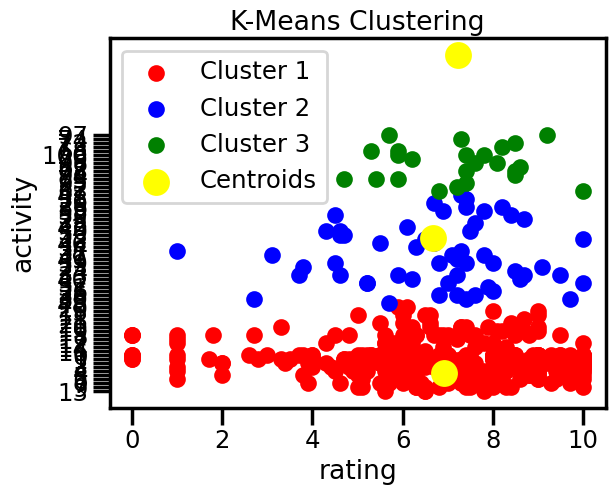

In [258]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Select only numeric columns for clustering
df6 = df[['rating', 'activity']].dropna()  # Remove NaNs if any

# Extract values for KMeans
X = df6.values

# Perform k-means clustering with k=3
kmeans = KMeans(n_clusters=3, random_state=42)
y_kmeans = kmeans.fit_predict(X)

# Visualize the clusters
plt.scatter(X[y_kmeans == 0, 0], X[y_kmeans == 0, 1], s=100, c='red', label='Cluster 1')
plt.scatter(X[y_kmeans == 1, 0], X[y_kmeans == 1, 1], s=100, c='blue', label='Cluster 2')
plt.scatter(X[y_kmeans == 2, 0], X[y_kmeans == 2, 1], s=100, c='green', label='Cluster 3')

# Plot centroids
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='yellow', label='Centroids')

plt.title('K-Means Clustering')
plt.xlabel('rating')
plt.ylabel('activity')
plt.legend()
plt.show()


Index(['no_of_reviews', 'activity'], dtype='object')


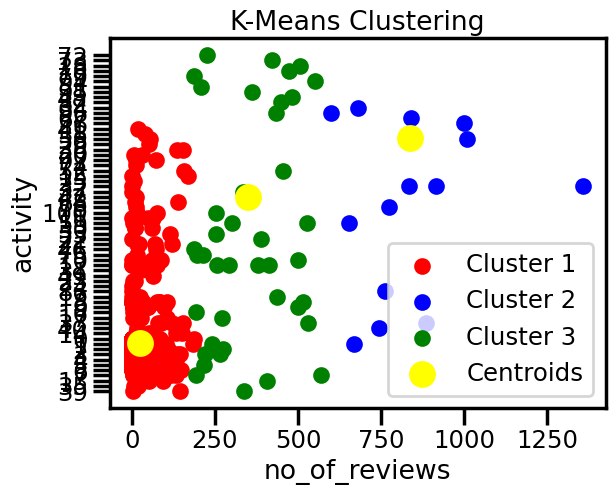

In [222]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# perform k-means clustering with k=3
print(df.columns)

df4=df[['no_of_reviews', 'activity']]
df = df.dropna()

X = df.values
X = df.values
kmeans = KMeans(n_clusters=3)
y_kmeans = kmeans.fit_predict(X)

# visualize the clusters with a scatter plot
plt.scatter(X[y_kmeans == 0, 0], X[y_kmeans == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(X[y_kmeans == 1, 0], X[y_kmeans == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(X[y_kmeans == 2, 0], X[y_kmeans == 2, 1], s = 100, c = 'green', label = 'Cluster 3')

plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 300, c = 'yellow', label = 'Centroids')
plt.title('K-Means Clustering')
plt.xlabel('no_of_reviews')
plt.ylabel('activity')
plt.legend()
plt.show()

,no_of_reviews,activity
0,760.0,87
1,449.0,82
2,482.0,48
4,146.0,39
5,8.0,35
...,...,...
2914,150.0,14
2918,1.0,6
2923,14.0,3
2924,40.0,3
